In [2]:
import rioxarray
import xarray as xr
import cartopy.crs as ccrs
import numpy as np
from rasterio.warp import calculate_default_transform, reproject, Resampling,transform
import matplotlib.pyplot as plt


In [3]:
da = xr.open_rasterio('data/cropland.tif')

In [3]:
# Compute the lon/lat coordinates with rasterio.warp.transform
ny, nx = len(da['y']), len(da['x'])
x, y = np.meshgrid(da['x'], da['y'])

# Rasterio works with 1D arrays
lon, lat = transform(da.crs, {'init': 'EPSG:4326'},
                     x.flatten(), y.flatten())
lon = np.asarray(lon).reshape((ny, nx))
lat = np.asarray(lat).reshape((ny, nx))
da.coords['lon'] = (('y', 'x'), lon)
da.coords['lat'] = (('y', 'x'), lat)

In [5]:
plt.figure(figsize=(10, 6))
ax = plt.subplot(projection=ccrs.Mollweide())
q = da.mean(dim='band')
q = q.where(q>0,drop=True)
q.plot.contourf(ax=ax, x='lon', y='lat', transform=ccrs.PlateCarree(),
               cmap='Greens', add_colorbar=False)
# da.mean(dim='band').plot(ax=ax, x='lon', y='lat', transform=ccrs.PlateCarree(),
#                cmap='Greys_r', add_colorbar=False)

KeyboardInterrupt: 

In [6]:
q = da.mean(dim='band')
q = q.where(q>0,drop=True)

q.plot.contourf(cmap='Greens',transform=ccrs.PlateCarree())

ValueError: Axes should be an instance of GeoAxes, got <class 'matplotlib.axes._subplots.AxesSubplot'>

In [14]:
x = xr.open_rasterio('data/cropland.tif')

In [15]:
moll = '+proj=moll +lon_0=0 +x_0=0 +y_0=0 +ellps=WGS84 +datum=WGS84 +units=m no_defs'

x2 = x.rio.reproject(moll)

In [22]:
q2 = x2.mean(dim='band')
q2 = q2.where(q2>0,drop=True)

C:\Users\Yinon\anaconda3\envs\py38\lib\site-packages\cartopy\io\__init__.py:260: DownloadWarning: Downloading: https://naciscdn.org/naturalearth/110m/physical/ne_110m_coastline.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)


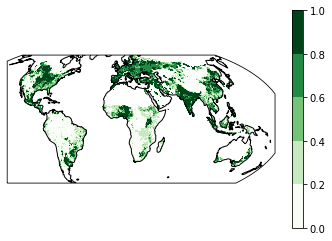

In [30]:
ax = plt.axes(projection=ccrs.Mollweide())
# q2.plot.contourf(ax=ax,cmap='Greens',transform=ccrs.Mollweide())
q.plot.contourf(cmap='Greens',transform=ccrs.PlateCarree())
ax.coastlines()

In [47]:
a

<xarray.DataArray (y: 2160, x: 4320)>
array([[-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38],
       [-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38],
       [-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38],
       ...,
       [-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38],
       [-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38],
       [-3.4028235e+38, -3.4028235e+38, -3.4028235e+38, ...,
        -3.4028235e+38, -3.4028235e+38, -3.4028235e+38]], dtype=float32)
Coordinates:
  * y        (y) float64 89.95 89.86 89.78 89.7 ... -89.71 -89.79 -89.88 -89.96
  * x        (x) float64 -180.0 -179.9 -179.8 -179.7 ... 179.7 179.8 179.9 179.9
    lon      (y, x) float64 -180.0 -179.9 -179.8 -179.7 ... 179.8 179.9 179.9
    lat      (y, x) float64 89.95 89.95 89.95 89.95 ... -89.96 -89.96 -89.96

In [53]:
da.where(da>=0)

<xarray.DataArray (band: 1, y: 2160, x: 4320)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)
Coordinates:
  * band     (band) int32 1
  * y        (y) float64 89.95 89.86 89.78 89.7 ... -89.71 -89.79 -89.88 -89.96
  * x        (x) float64 -180.0 -179.9 -179.8 -179.7 ... 179.7 179.8 179.9 179.9
    lon      (y, x) float64 -180.0 -179.9 -179.8 -179.7 ... 179.8 179.9 179.9
    lat      (y, x) float64 89.95 89.95 89.95 89.95 ... -89.96 -89.96 -89.96
Attributes:
    transform:      (0.08332825, 0.0, -180.0, 0.0, -0.08332825, 89.9890200000...
    crs:            +init=epsg:4326
    res:            (0.08332825, 0.08332825)
    is_tiled:       0
    nodatavals:     (-3.4028234663852886e+38,)
    scales:         (1.0,)
    offsets:        (0.0,)
    AREA_OR_POINT:  Area

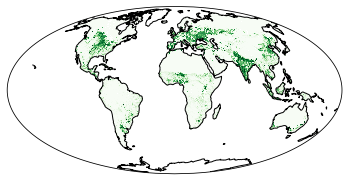

In [5]:
a = da.mean(dim='band')
# a = a.where(a>=0,drop=True)
ax = plt.axes(projection=ccrs.Mollweide())
ax.imshow(a.where(a>=0),cmap='Greens',transform=ccrs.PlateCarree(),interpolation='none')
ax.coastlines()